<a href="https://colab.research.google.com/github/ArpitaChatterjee/Face-Detector/blob/main/Face_Detector.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [43]:
import cv2
from random import randrange

In [82]:
from google.colab.patches import cv2_imshow

In [44]:
#load some pretrained frontal face frm opencv (haar cascade algorithm)
#its supervised lerning where the algo has 5 haar features.
#step1-> distinguish face n non face
#step2-> weve to test every haar feature... on training img- every type , size location(each hf gives a no right or wrong)
# which every haar features chooses the training img closest is our first winner -- its decides by the color differences in the img
#so we change the img into grayscale so that its easy for the hf to detect the light n dark areas in the face(eyes darker than cheeks) n deteact the exact location of the face.
#step3-> the 'cascade'-- once we got 1st 1000 winner of hf, we can chain them together into our face dectector which is donr by cascadeclassifier n stored in xml file



trained_facedata = cv2.CascadeClassifier('/content/drive/MyDrive/Colab Notebooks/Face-Detector/haarcascade_frontalface_default.xml')

In [81]:
#choose the img to be read
#img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Face-Detector/rdj.jpg')
img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Face-Detector/bts3.jpg')

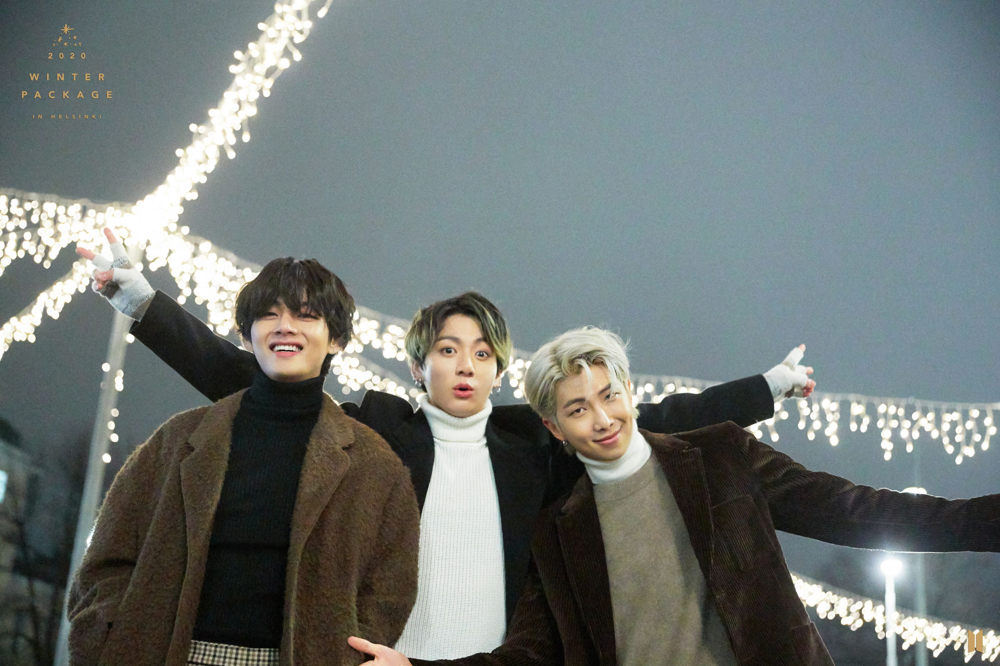

-1

In [83]:
cv2_imshow(img)
cv2.waitKey()

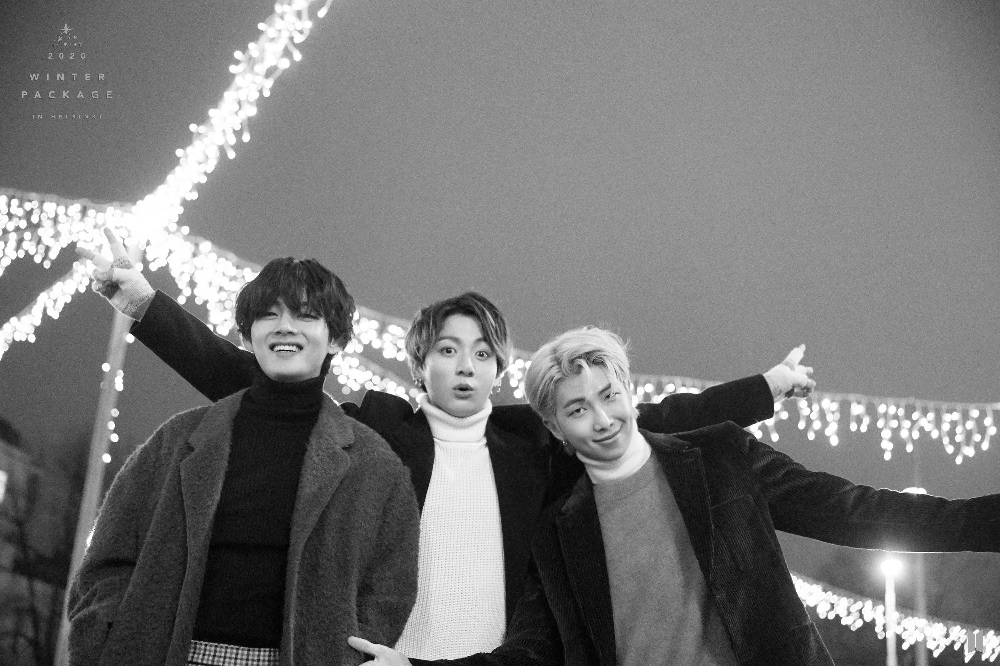

-1

In [84]:
#convert it to greyscale
gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray_img)
cv2.waitKey()

In [85]:
#detect faces-- detectMultiScale->detect all the scale of the face irrespective of any shape
face_coordinates = trained_facedata.detectMultiScale(gray_img)

In [86]:
print(face_coordinates)
#upperleft corner(144,128) and downright corner(297, 297) coordinates
#(x, y, w, h) x,y-coord & width, height of the img

[[1246  948  291  291]
 [ 715  835  279  279]
 [1588  976  323  323]
 [1142  975   92   92]
 [1526 1055   77   77]
 [ 898 1257  229  229]
 [1139 1364   73   73]
 [1168 1450   91   91]
 [ 881 1490   55   55]
 [ 865 1507   96   96]]


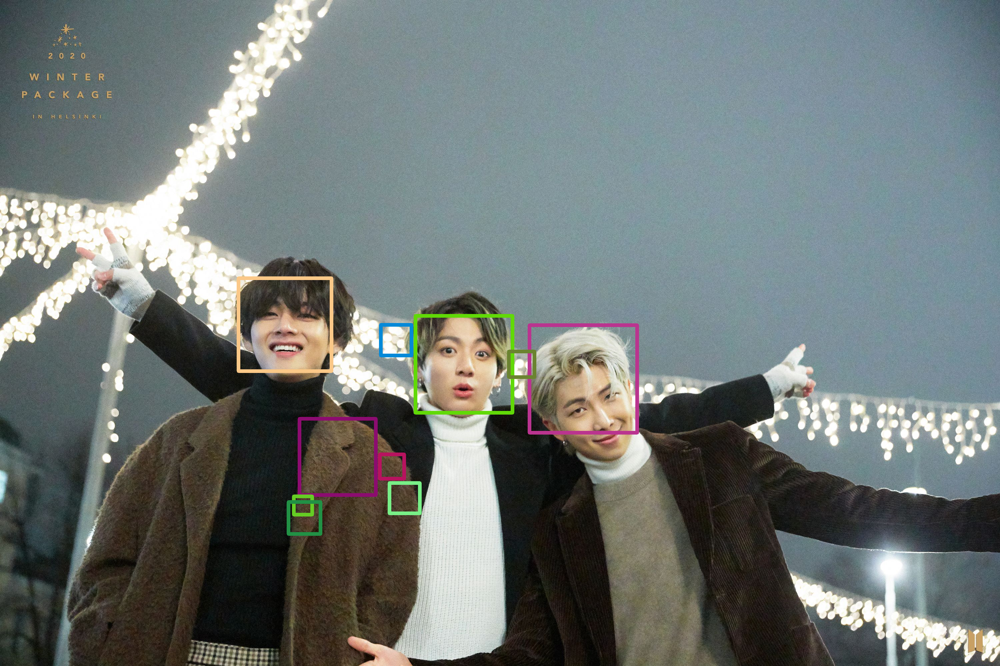

-1

In [89]:
#draw rectectangles (x,y), (x+w, y+h), (b,g,r), widthofrectangle
for (x,y, w, h) in face_coordinates:
  cv2.rectangle(img, (x,y), (x+w, y+h), (randrange(255),randrange(255),randrange(255)), 10)

cv2_imshow(img)
cv2.waitKey()

In [90]:
# import dependencies
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import cv2
import numpy as np
import PIL
import io
import html
import time
from pathlib import Path

In [77]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [91]:
# function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """
  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

# function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
  """
  Params:
          bbox_array: Numpy array (pixels) containing rectangle to overlay on video stream.
  Returns:
        bytes: Base64 image byte string
  """
  # convert array into PIL image
  bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
  iobuf = io.BytesIO()
  # format bbox into png for return
  bbox_PIL.save(iobuf, format='png')
  # format return string
  bbox_bytes = 'data:image/png;base64,{}'.format((str(b64encode(iobuf.getvalue()), 'utf-8')))

  return bbox_bytes

In [93]:
for imgId in range(4):
  def take_photo(filename='photo.jpg', quality=0.8):
    js = Javascript('''
      async function takePhoto(quality) {
        const div = document.createElement('div');
        const capture = document.createElement('button');
        capture.textContent = 'Capture';
        div.appendChild(capture);

        const video = document.createElement('video');
        video.style.display = 'block';
        const stream = await navigator.mediaDevices.getUserMedia({video: true});

        document.body.appendChild(div);
        div.appendChild(video);
        video.srcObject = stream;
        await video.play();

        // Resize the output to fit the video element.
        google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

        // Wait for Capture to be clicked.
        await new Promise((resolve) => capture.onclick = resolve);

        const canvas = document.createElement('canvas');
        canvas.width = video.videoWidth;
        canvas.height = video.videoHeight;
        canvas.getContext('2d').drawImage(video, 0, 0);
        stream.getVideoTracks()[0].stop();
        div.remove();
        return canvas.toDataURL('image/jpeg', quality);
      }
      ''')
    display(js)

    # get photo data
    data = eval_js('takePhoto({})'.format(quality))
    # get OpenCV format image
    img = js_to_image(data) 
    # grayscale img
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    print(gray.shape)
    # get face bounding box coordinates using Haar Cascade
    faces = face_cascade.detectMultiScale(gray)
    # draw face bounding box on image
    for (x,y,w,h) in faces:
        img = cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)

    # save image
    cv2.imwrite("/content/drive/MyDrive/{}/{}_{}.jpg".format(classname, userId, imgId), img)

      #print("[INFO] Image {} has been saved in folder : {}".format(imgId, classname))
      #cv2.imwrite(filename, img)

    return filename


  try:
    classname1=classname+".jpg"
    filename = take_photo(classname1)
    print('Saved to {}'.format(filename))
    
    # Show the image which was just taken.
  
    display(Image(filename))
  except Exception as err:
    # Errors will be thrown if the user does not have a webcam or if they do not
    # grant the page permission to access it.
    print(str(err))

name 'classname' is not defined
name 'classname' is not defined
name 'classname' is not defined
name 'classname' is not defined


In [ ]:
webcam = cv2.VideoCapture('/content/drive/MyDrive/Colab Notebooks/Face-Detector/gif.mp4')

#iterate over the frame
while True:
  ##read current frame
  successful_frame_read, frame= webcam.read()

  #must convert to greyscale
  gray_img = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

  face_coordinates = trained_facedata.detectMultiScale(gray_img)

  for (x,y, w, h) in face_coordinates:
    cv2.rectangle(frame, (x,y), (x+w, y+h), (randrange(255),randrange(255),randrange(255)), 10)

  cv2_imshow(frame)
  key= cv2.waitKey(1) 

  if key == 81 or key==113:
    break
#clean the data
webcam.release()

In [80]:
#to capture video
webcam = cv2.VideoCapture(filename)
key= cv2.waitKey(1)